In [50]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.animation import FuncAnimation

##### import required libraries.

##### Load diamond dataset

In [51]:
df = pd.read_csv(r'C:\Users\Sonu Vikas\Desktop\ANACONDA\AI,ML,DL\diamondsAIML.csv')

In [52]:
df

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...,...
53935,53936,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,53937,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,53938,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,53939,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


##### Remove Unknown Column

In [16]:
df.drop(columns = 'Unnamed: 0',inplace = True)

In [18]:
df

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


In [20]:
df.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [22]:
df.tail()

,carat,cut,color,clarity,depth,table,price,x,y,z
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74
53939,0.75,Ideal,D,SI2,62.2,55.0,2757,5.83,5.87,3.64


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    53940 non-null  float64
 1   cut      53940 non-null  object 
 2   color    53940 non-null  object 
 3   clarity  53940 non-null  object 
 4   depth    53940 non-null  float64
 5   table    53940 non-null  float64
 6   price    53940 non-null  int64  
 7   x        53940 non-null  float64
 8   y        53940 non-null  float64
 9   z        53940 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 4.1+ MB


#  Univariate Analysis

##### Histogram
##### Bar Plot
##### Pie Chart

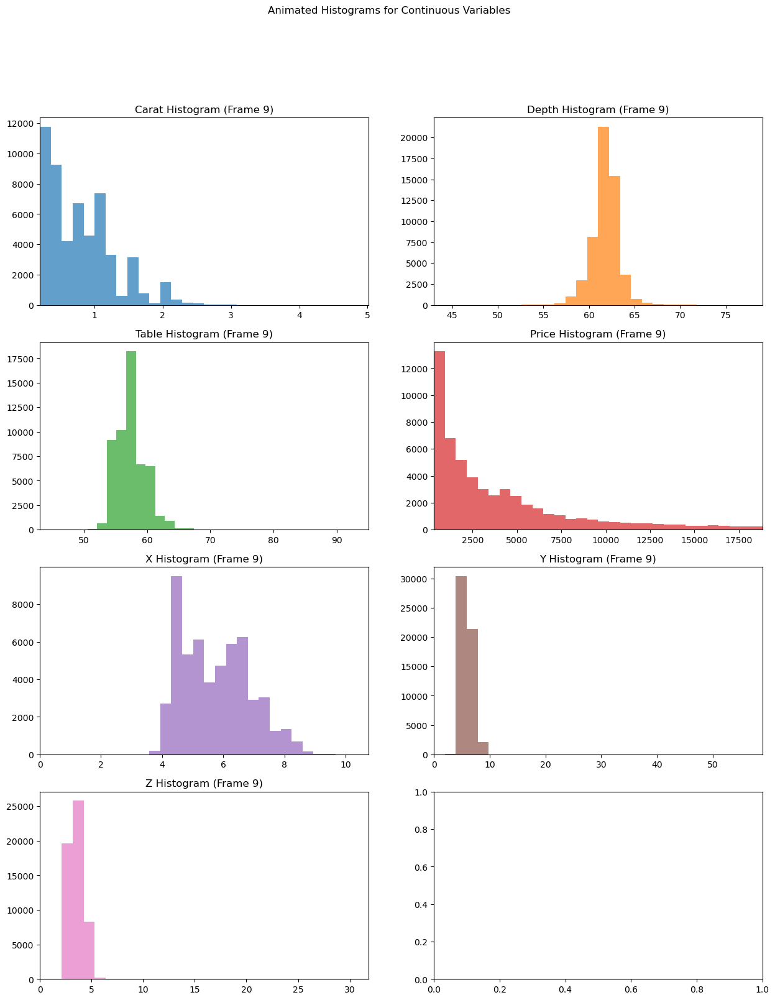

In [26]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Read the CSV file into a DataFrame
df = pd.read_csv(r'C:\Users\Sonu Vikas\Desktop\ANACONDA\AI,ML,DL\diamondsAIML.csv')

# List of continuous variable columns
continuous_columns = ["carat", "depth", "table", "price", "x", "y", "z"]

# Calculate the number of rows and columns for subplots
num_cols = 2  # Number of columns in the subplot grid
num_rows = int(np.ceil(len(continuous_columns) / num_cols))  # Calculate the number of rows

# Create a figure and axis for the subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 18))
fig.suptitle("Animated Histograms for Continuous Variables")

# Define different colors for each column
custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2']

# Create initial empty histograms for each column with different colors
histograms = [ax.hist([], bins=30, alpha=0.7, color=custom_colors[i])[0] for i, ax in enumerate(axes.flat) if i < len(continuous_columns)]

# Update function for animation
def update(frame):
    for i, col in enumerate(continuous_columns):
        if i < len(axes.flat):
            ax = axes.flat[i]
            ax.clear()
            ax.set_title(f"{col.capitalize()} Histogram (Frame {frame})")
            ax.set_xlim(min(df[col]), max(df[col]))
            
            # Generate data for the current frame
            frame_data = np.random.choice(df[col], size=len(df))
            
            # Update the histogram
            n, bins, patches = ax.hist(frame_data, bins=30, alpha=0.7, color=custom_colors[i])
            histograms[i] = patches
            
    return histograms

# Create the animation
animation = FuncAnimation(fig, update, frames=10, repeat=False, interval=500)

# Save the animation as a GIF
animation.save("animated_histograms_custom_colors.gif", writer="pillow")

plt.show()


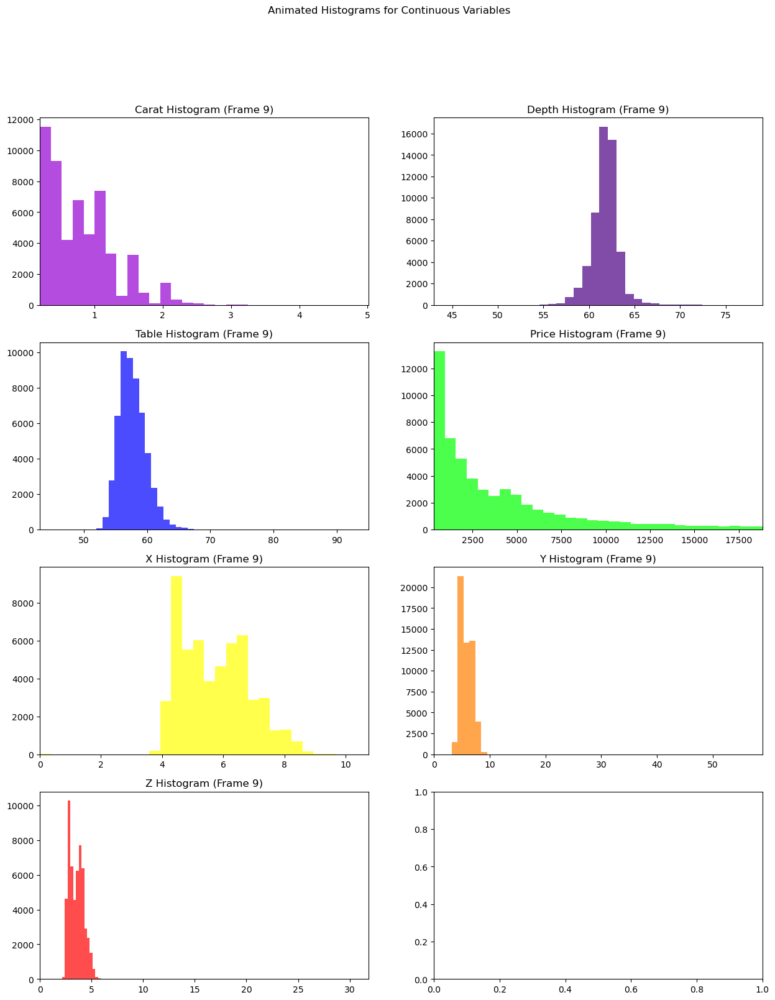

In [28]:
from matplotlib.animation import FuncAnimation

# List of continuous variable columns
continuous_columns = ["carat", "depth", "table", "price", "x", "y", "z"]

# Calculate the number of rows and columns for subplots
num_cols = 2  # Number of columns in the subplot grid
num_rows = int(np.ceil(len(continuous_columns) / num_cols))  # Calculate the number of rows

# Create a figure and axis for the subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 18))
fig.suptitle("Animated Histograms for Continuous Variables")

# Define colors in a vibgyor pattern
vibgyor_colors = ['#9400D3', '#4B0082', '#0000FF', '#00FF00', '#FFFF00', '#FF7F00', '#FF0000']

# Create initial empty histograms for each column with vibgyor colors
histograms = [ax.hist([], bins=30, alpha=0.7, color=vibgyor_colors[i])[0] for i, ax in enumerate(axes.flat) if i < len(continuous_columns)]

# Update function for animation
def update(frame):
    for i, col in enumerate(continuous_columns):
        if i < len(axes.flat):
            ax = axes.flat[i]
            ax.clear()
            ax.set_title(f"{col.capitalize()} Histogram (Frame {frame})")
            ax.set_xlim(min(df[col]), max(df[col]))
            
            # Generate data for the current frame
            frame_data = np.random.choice(df[col], size=len(df))
            
            # Update the histogram
            n, bins, patches = ax.hist(frame_data, bins=30, alpha=0.7, color=vibgyor_colors[i])
            histograms[i] = patches
            
    return histograms

# Create the animation
animation = FuncAnimation(fig, update, frames=10, repeat=False, interval=500)

# Save the animation as a GIF
animation.save("animated_histograms_vibgyor.gif", writer="pillow")

plt.show()

C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  bar_colors = plt.cm.get_cmap("tab20")(np.linspace(0, 1, num_categories))
C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  bar_colors = plt.cm.get_cmap("tab20")(np.linspace(0, 1, num_categories))
C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap

C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  bar_colors = plt.cm.get_cmap("tab20")(np.linspace(0, 1, num_categories))
C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  bar_colors = plt.cm.get_cmap("tab20")(np.linspace(0, 1, num_categories))
C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\856987700.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap

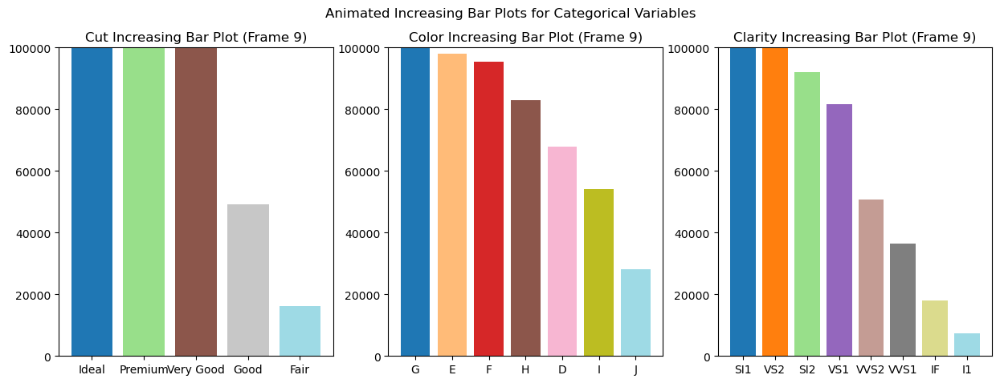

In [30]:
# List of categorical variable columns
categorical_columns = ["cut", "color", "clarity"]

# Create a figure and axis for the subplots
fig, axes = plt.subplots(1, len(categorical_columns), figsize=(15, 5))
fig.suptitle("Animated Increasing Bar Plots for Categorical Variables")

# Initialize y-axis limits
initial_y_limit = 0
max_y_limit = 100000

# Update function for animation
def update(frame):
    for i, col in enumerate(categorical_columns):
        ax = axes[i]
        ax.clear()
        ax.set_title(f"{col.capitalize()} Increasing Bar Plot (Frame {frame})")
        
        # Calculate the frequency of each category in the original data
        category_counts = df[col].value_counts()
        
        # Get unique categories for the current variable
        categories = category_counts.index
        
        # Calculate new bar heights for the current frame
        new_heights = {category: (frame + 1) * count for category, count in zip(categories, category_counts)}
        
        # Generate a unique color for each bar
        num_categories = len(categories)
        bar_colors = plt.cm.get_cmap("tab20")(np.linspace(0, 1, num_categories))
        
        # Update bar heights for the current variable within y-axis limits
        bars = []
        for category, color in zip(categories, bar_colors):
            bar = ax.bar(category, min(new_heights[category], max_y_limit), color=color)
            bars.append(bar)
        
        # Set y-axis limits and tick locations
        ax.set_ylim(initial_y_limit, max_y_limit)
        ax.set_yticks(np.arange(initial_y_limit, max_y_limit + 1, 20000))
        ax.yaxis.grid(False)  # Turn off y-axis grid lines
        
    return bars

# Create the animation
animation = FuncAnimation(fig, update, frames=10, repeat=False, interval=500)

# Save the animation as a GIF
animation.save("animated_increasing_categorical_bar_plots_no_grid.gif", writer="pillow")

plt.show()

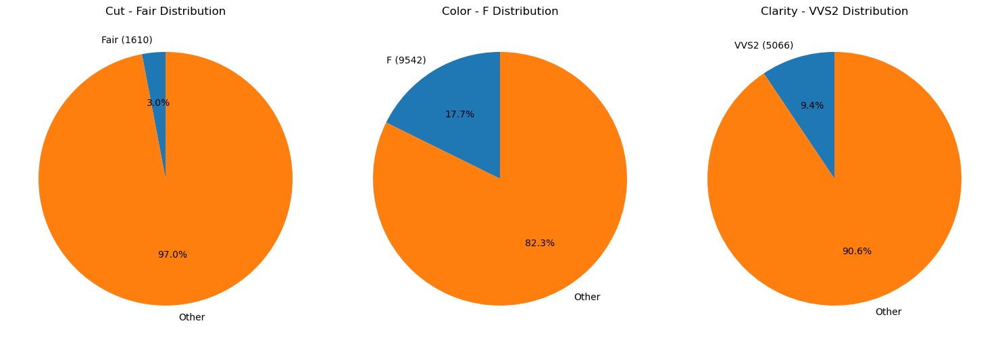

In [32]:
# Variables for which pie charts will be created
variables = ["cut", "color", "clarity"]

# Set up the figure and axis
fig, axs = plt.subplots(1, len(variables), figsize=(15, 5))

# Define custom colors
custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2']

# Function to update the animation
def animate(frame):
    for i, variable in enumerate(variables):
        ax = axs[i]
        ax.clear()
        data = df[df[variable] == df[variable].unique()[frame]]
        counts = data['price'].count()
        labels = data[variable].iloc[0]
        sizes = [counts, len(df) - counts]
        ax.pie(sizes, labels=[f'{labels} ({counts})', 'Other'], autopct='%1.1f%%', startangle=90, colors=custom_colors)
        ax.set_title(f'{variable.capitalize()} - {labels} Distribution')

# Create the animation
ani = FuncAnimation(fig, animate, frames=len(df[variables[0]].unique()), interval=1000, repeat=False)
ani.save("Animated_pie_graphs_colored.gif", writer="pillow")

# Show the animation
plt.tight_layout()
plt.show()

# Bivariate Analysis

##### Scatterplots and Stacked Barplots

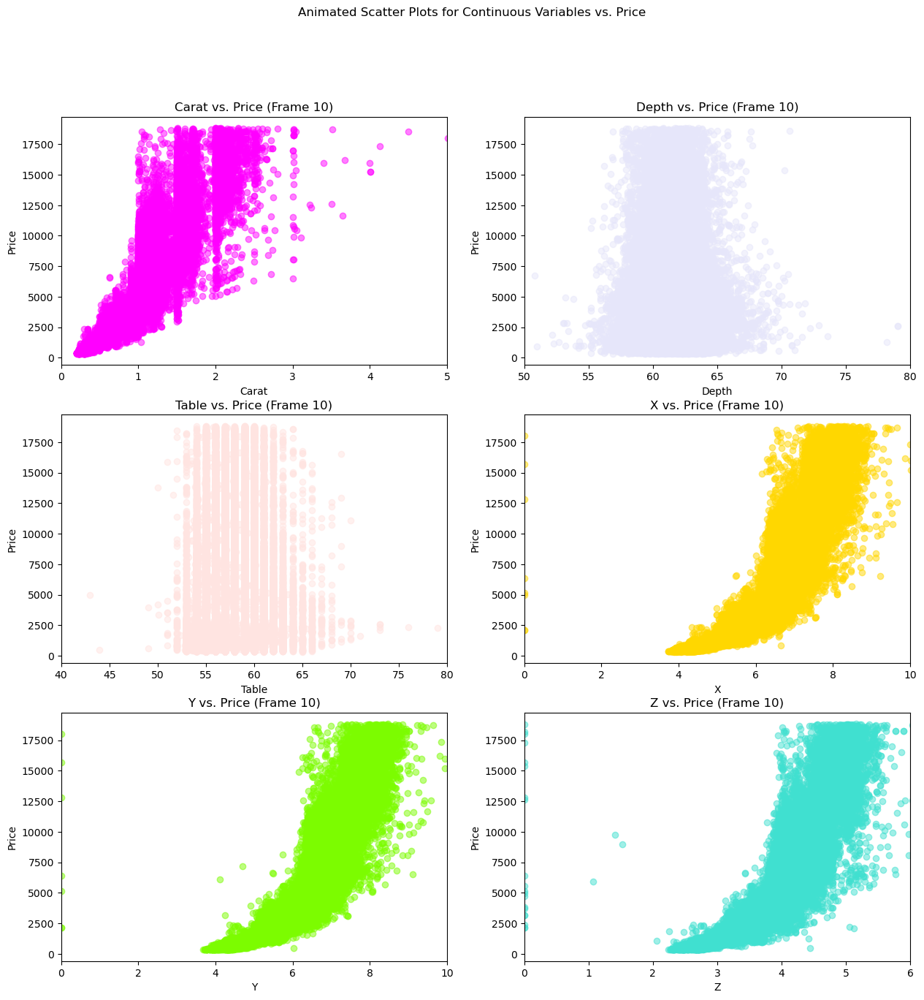

In [34]:
# List of continuous variable columns
continuous_columns = ["carat", "depth", "table", "x", "y", "z"]

# Create a figure and axis for the subplots
num_rows = len(continuous_columns) // 2 + len(continuous_columns) % 2
fig, axes = plt.subplots(num_rows, 2, figsize=(15, 5*num_rows))
fig.suptitle("Animated Scatter Plots for Continuous Variables vs. Price")

# Define colors for the scatter plots
colors = ['magenta', 'lavender', 'mistyrose', 'gold', 'lawngreen', 'turquoise']

# Set constant x-axis limits
x_limits = {
    "carat": (0, 5),
    "depth": (50, 80),
    "table": (40, 80),
    "x": (0, 10),
    "y": (0, 10),
    "z": (0, 6)
}

# Update function for animation
def update(frame):
    for i, col in enumerate(continuous_columns):
        row = i // 2
        column = i % 2
        ax = axes[row, column]
        ax.clear()
        ax.set_title(f"{col.capitalize()} vs. Price (Frame {frame+1})")
        ax.set_xlabel(col.capitalize())
        ax.set_ylabel("Price")
        
        # Calculate the number of data points to display for the current frame
        num_points = len(df) * (frame + 1) // 10
        
        # Select data for the current frame
        sample_data = df.sample(n=num_points)
        
        # Update scatter plot with different colors and constant x-axis limits
        ax.scatter(sample_data[col], sample_data["price"], color=colors[i], alpha=0.5)
        ax.set_xlim(x_limits[col])
    
    return axes

# Create the animation
animation = FuncAnimation(fig, update, frames=10, repeat=False,interval=500)

# Save the animation as a GIF
animation.save("animated_continuous_features_vs_price_scatter_plots_colored.gif", writer="pillow")

plt.show()


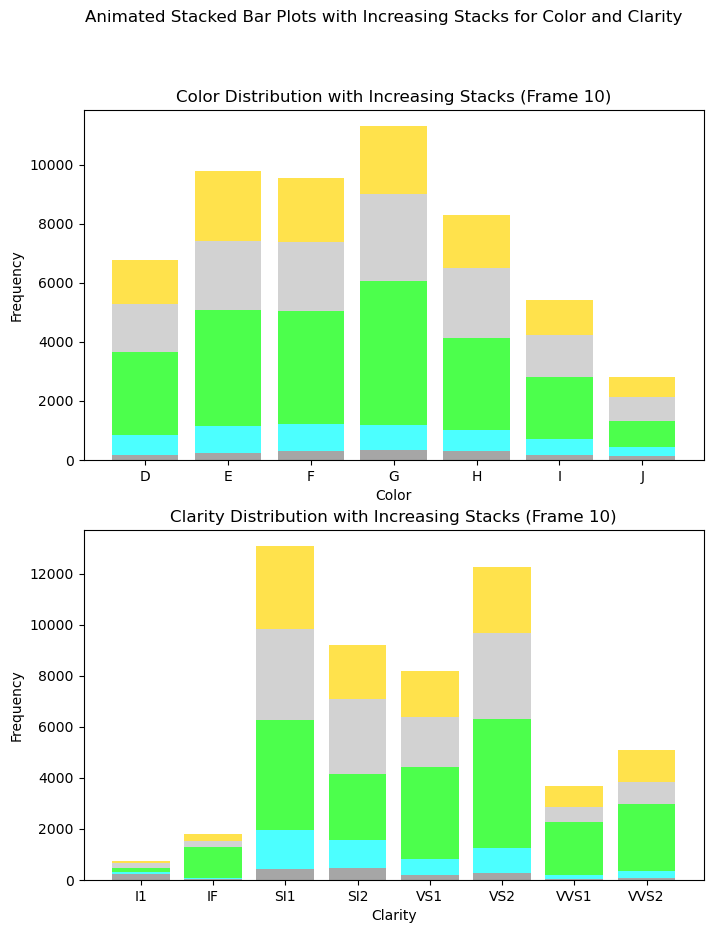

In [36]:
# List of categorical variable columns
categorical_columns = ["color", "clarity"]

# Create a figure and axis for the subplots
num_rows = len(categorical_columns)
fig, axes = plt.subplots(num_rows, 1, figsize=(8, 5*num_rows))
fig.suptitle("Animated Stacked Bar Plots with Increasing Stacks for Color and Clarity")

# Define colors for the stacked bar plots
colors = ['grey','aqua','lime','silver','gold','sandybrown','orchid','purple']


# Update function for animation
def update(frame):
    j=0
    for i, col in enumerate(categorical_columns):
        ax = axes[i]
        ax.clear()
        ax.set_title(f"{col.capitalize()} Distribution with Increasing Stacks (Frame {frame+1})")
        ax.set_xlabel(col.capitalize())
        ax.set_ylabel("Frequency")
        
        # Calculate the number of data points to display for the current frame
        num_points = len(df) * (frame + 1) // 10
        
        # Select data for the current frame
        sample_data = df.sample(n=num_points)
        
        # Create a stacked bar plot with increasing stacks
        cross_tab = pd.crosstab(sample_data["cut"], sample_data[col])
        bottom = None
        for index, row in cross_tab.iterrows():
            ax.bar(row.index, row.values, bottom=bottom, color=colors[j], alpha=0.7)
            if bottom is None:
                bottom = row.values
            else:
                bottom += row.values
            j+=1
        j=0
    return axes

# Create the animation with a 0.5 second delay between frames
animation = FuncAnimation(fig, update, frames=10, repeat=False, interval=500)

# Save the animation as a GIF
animation.save("animated_stacked_bar_graphs.gif", writer="pillow")

plt.show()

# Multivariate Analysis

##### Scatter Plot

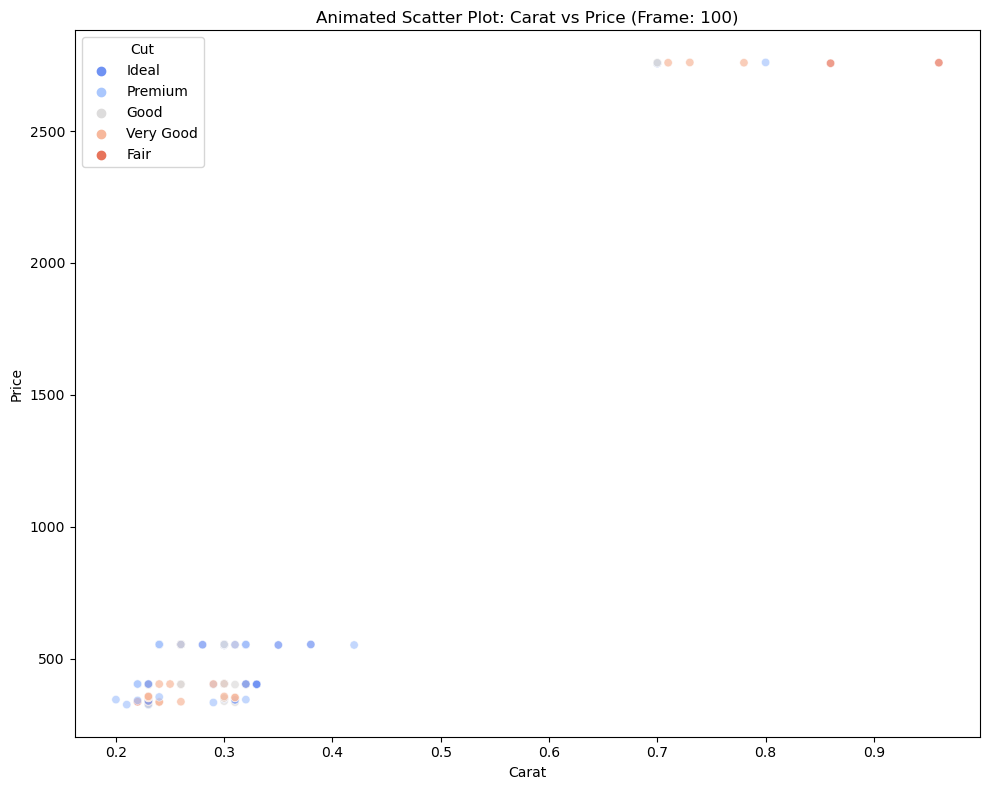

In [40]:
# Set up the figure and axis
fig, ax = plt.subplots(figsize=(10, 8))

# Function to update the animation
def animate(frame):
    ax.clear()
    sns.scatterplot(data=df.iloc[:frame + 1], x="carat", y="price", hue="cut", palette="coolwarm", alpha=0.7)
    ax.set_xlabel("Carat")
    ax.set_ylabel("Price")
    ax.set_title(f"Animated Scatter Plot: Carat vs Price (Frame: {frame + 1})")
    ax.legend(title="Cut")

# Create the animation
ani = FuncAnimation(fig, animate, frames=100, interval=100, repeat=False)
ani.save("Multivariate_analysis_carat_price_cut_coolwarm.gif", writer="pillow")

# Show the animation
plt.tight_layout()
plt.show()

In [71]:
import plotly.express as px
custom_palette = px.colors.qualitative.Set1
# Scatter plot with color-coded hue (cut)
scatter = px.scatter(df, x="carat", y="price", color="clarity", title="Scatter Plot: Carat vs Price with Hue (Clarity)")
scatter.show()

In [68]:
# Create an animated bubble chart
bubble_chart = px.scatter(df, x="carat", y="price", size="carat",color = 'color',
                          title="Bubble Chart: Carat vs Price",
                          labels={"carat": "Carat", "price": "Price"},
                          range_x=[0, 5], range_y=[0, 20000],
                          size_max=30, template="plotly")
bubble_chart.show()

In [73]:
# Histogram of carat
hist = px.histogram(df, x="price", nbins=50, title="Histogram: Price Distribution")
hist.show()


In [74]:
# Scatter plot matrix
scatter_matrix = px.scatter_matrix(df, dimensions=["carat", "depth", "table", "price"],
                                   color="cut", title="Scatter Plot Matrix")
scatter_matrix.show()

F:\Python\lib\site-packages\plotly\express\_core.py:279: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



In [76]:
# Calculate the correlation matrix
correlation_matrix = df.corr()
correlation_matrix

C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\1973928281.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



,Unnamed: 0,carat,depth,table,price,x,y,z
Unnamed: 0,1.000000,-0.377983,-0.034800,-0.100830,-0.306873,-0.405440,-0.395843,-0.399208
carat,-0.377983,1.000000,0.028224,0.181618,0.921591,0.975094,0.951722,0.953387
depth,-0.034800,0.028224,1.000000,-0.295779,-0.010647,-0.025289,-0.029341,0.094924
table,-0.100830,0.181618,-0.295779,1.000000,0.127134,0.195344,0.183760,0.150929
price,-0.306873,0.921591,-0.010647,0.127134,1.000000,0.884435,0.865421,0.861249
x,-0.405440,0.975094,-0.025289,0.195344,0.884435,1.000000,0.974701,0.970772
y,-0.395843,0.951722,-0.029341,0.183760,0.865421,0.974701,1.000000,0.952006
z,-0.399208,0.953387,0.094924,0.150929,0.861249,0.970772,0.952006,1.000000


In [83]:
# Create a heatmap of the correlation matrix
heatmap = px.imshow(correlation_matrix,
                    labels=dict(x="Variables", y="Variables"),
                    x=correlation_matrix.columns,
                    y=correlation_matrix.columns,
                    title="Heatmap of Correlation between Continuous Variables",
                    color_continuous_scale='agsunset',
                    color_continuous_midpoint=0)

# Customize the color bar
heatmap.update_layout(coloraxis_colorbar=dict(title="Correlation"))

heatmap.show()


In [91]:
# 3D Scatter Plot
scatter_3d = px.scatter_3d(df, x='carat', y='depth', z='price',
                           color='cut', size='table',
                           title='3D Scatter Plot: Carat vs Depth vs Price',
                           labels={'carat': 'Carat', 'depth': 'Depth', 'price': 'Price', 'cut': 'Cut', 'table': 'Table'})
scatter_3d.show()

In [92]:
# 3D Line Plot
line_3d = px.line_3d(df, x='carat', y='depth', z='price',
                     color='cut',
                     title='3D Line Plot: Carat vs Depth vs Price',
                     labels={'carat': 'Carat', 'depth': 'Depth', 'price': 'Price', 'cut': 'Cut'})
line_3d.show()

# Descriptive Statistics

In [87]:
continuous_features = ['carat','depth','table','x','y','z','price']
df[continuous_features].describe()

,carat,depth,table,x,y,z,price
count,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000
mean,0.797940,61.749405,57.457184,5.731157,5.734526,3.538734,3932.799722
std,0.474011,1.432621,2.234491,1.121761,1.142135,0.705699,3989.439738
min,0.200000,43.000000,43.000000,0.000000,0.000000,0.000000,326.000000
25%,0.400000,61.000000,56.000000,4.710000,4.720000,2.910000,950.000000
50%,0.700000,61.800000,57.000000,5.700000,5.710000,3.530000,2401.000000
75%,1.040000,62.500000,59.000000,6.540000,6.540000,4.040000,5324.250000
max,5.010000,79.000000,95.000000,10.740000,58.900000,31.800000,18823.000000


C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\4111062221.py:5: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



<Figure size 1400x1400 with 0 Axes>

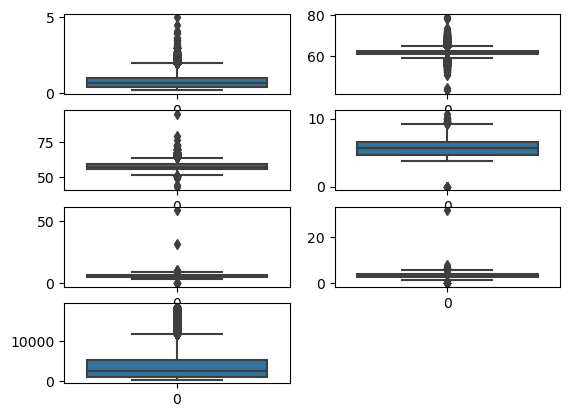

In [88]:
plt.figure(figsize=(14,14))
plt.subplots()
i=1
for feature in continuous_features:
    plt.subplot(4,2,i)
    sns.boxplot(df[feature])
    i+=1

# Test for Hypothesis
Hypothesis:

Null Hypothesis (H0): There is no significant difference in the average price of diamonds among different cut categories.

Alternative Hypothesis (H1): There is a significant difference in the average price of diamonds among different cut categories

For this type of testing we use ANOVA (Analysis of variance).

In [90]:
import scipy.stats as stats

# Group the data by cut and calculate the means
grouped_data = df.groupby('cut')['price'].mean()

# Perform ANOVA
anova_result = stats.f_oneway(
    df[df['cut'] == 'Fair']['price'],
    df[df['cut'] == 'Good']['price'],
    df[df['cut'] == 'Very Good']['price'],
    df[df['cut'] == 'Premium']['price'],
    df[df['cut'] == 'Ideal']['price']
)

# Print the ANOVA results
print("ANOVA Results:")
print("F-statistic:", anova_result.statistic)
print("p-value:", anova_result.pvalue)

# Interpret the results - alpha- sig
alpha = 0.05
if anova_result.pvalue < alpha:
    print("Reject the null hypothesis. There is a significant difference in the average price among different cut categories.")
else:
    print("Fail to reject the null hypothesis. There is no significant difference in the average price among different cut categories.")


ANOVA Results:
F-statistic: 175.6887173508061
p-value: 8.42830730759452e-150
Reject the null hypothesis. There is a significant difference in the average price among different cut categories.


# Univariate Plots from the dataframe.

1.Numeric based plots

2.Categorical based plots

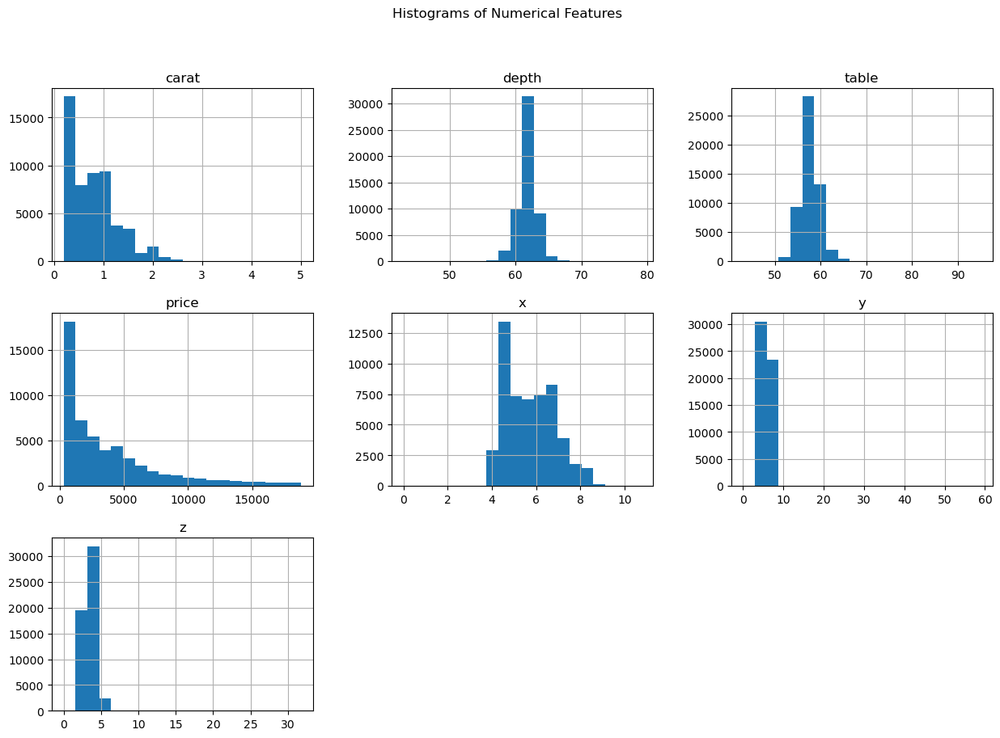

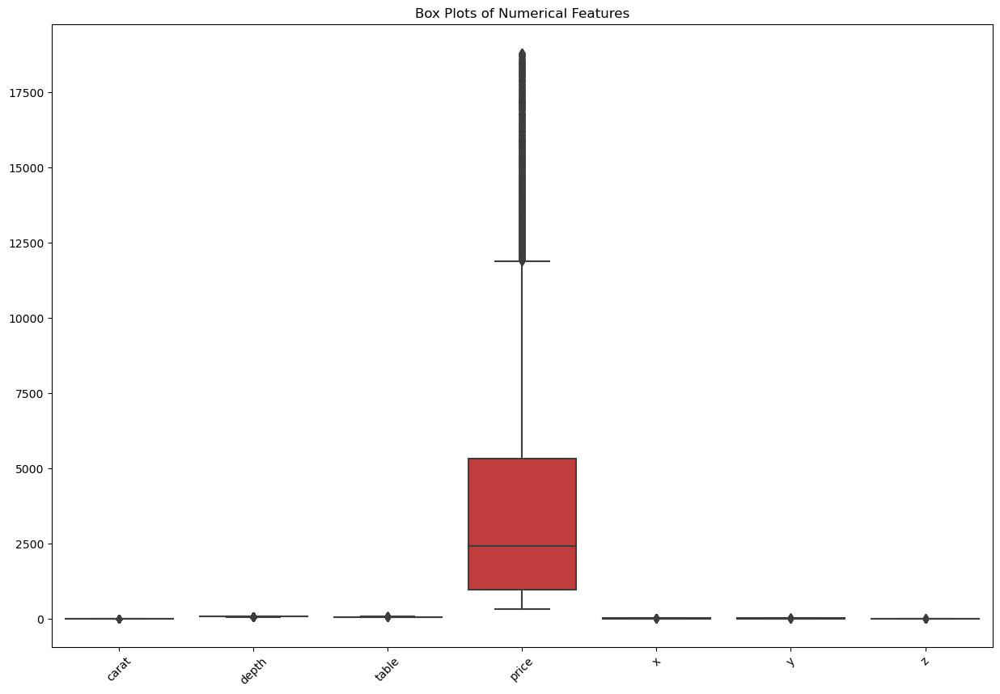

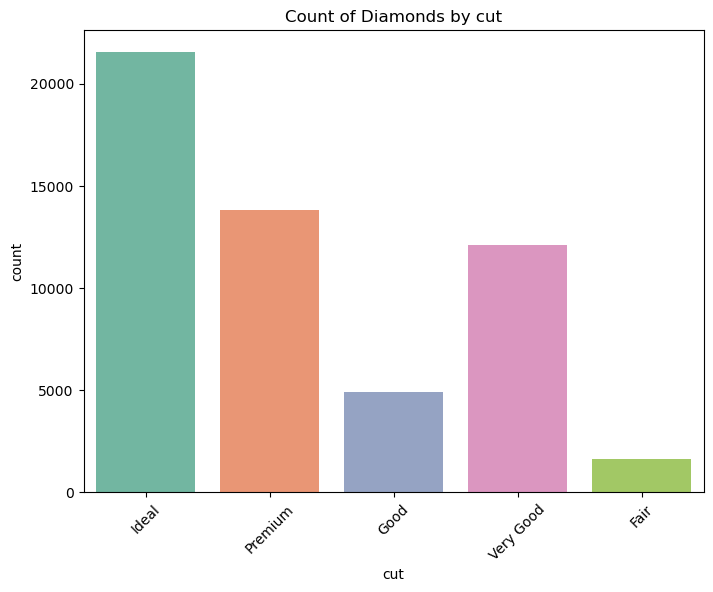

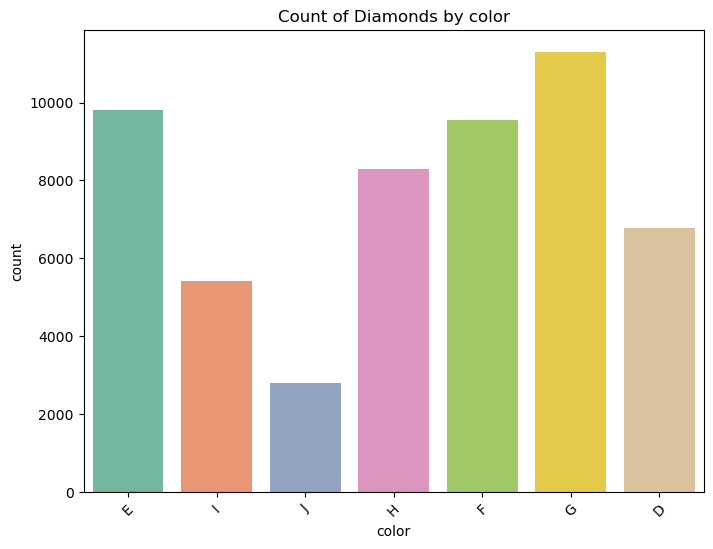

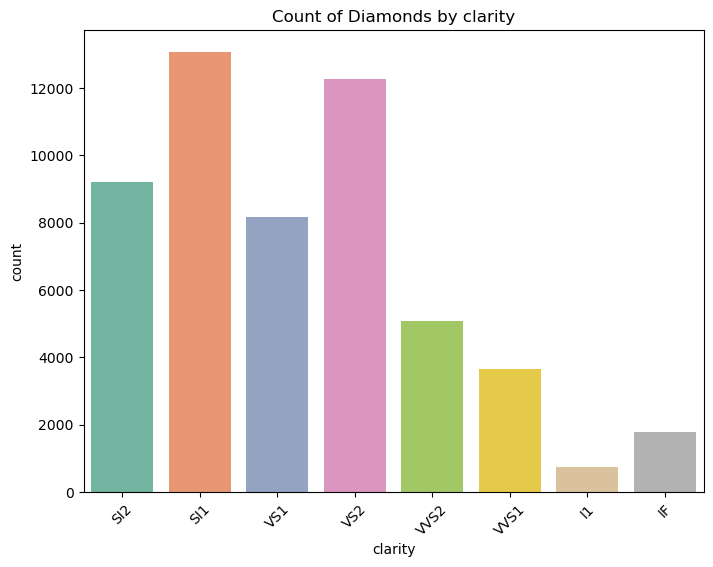

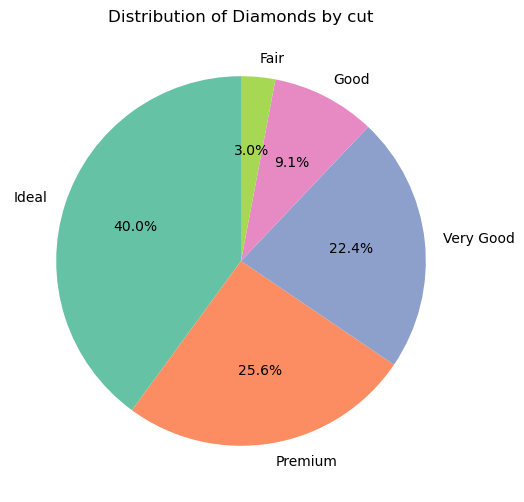

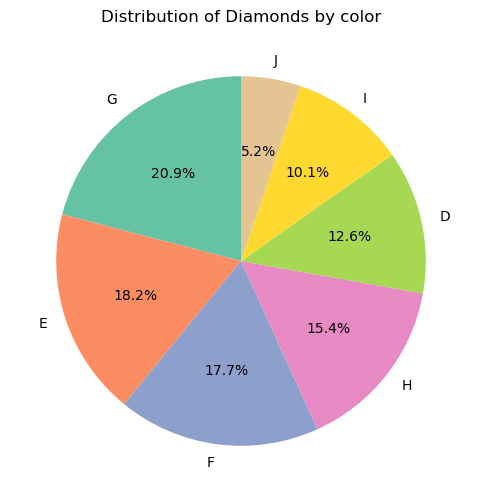

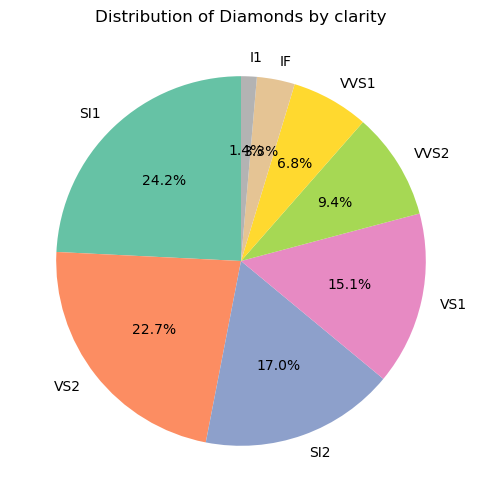

In [93]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Read the CSV file into a DataFrame
df = pd.read_csv(r'C:\Users\Sonu Vikas\Desktop\ANACONDA\AI,ML,DL\diamondsAIML.csv')

# Univariate Analysis - Numerical based plot
numerical_columns = ['carat', 'depth', 'table', 'price', 'x', 'y', 'z']

# Histograms
df[numerical_columns].hist(bins=20, figsize=(15, 10))
plt.suptitle("Histograms of Numerical Features")
plt.show()

# Box plots
plt.figure(figsize=(15, 10))
sns.boxplot(data=df[numerical_columns])
plt.title("Box Plots of Numerical Features")
plt.xticks(rotation=45)
plt.show()

# Univariate Analysis - Categorical based plot
categorical_columns = ['cut', 'color', 'clarity']

# Bar plots
for col in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.countplot(data=df, x=col, palette='Set2')
    plt.title(f"Count of Diamonds by {col}")
    plt.xticks(rotation=45)
    plt.show()

# Pie charts (for categorical variables)
for col in categorical_columns:
    plt.figure(figsize=(8, 6))
    df[col].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=90, colors=sns.color_palette('Set2'))
    plt.title(f"Distribution of Diamonds by {col}")
    plt.ylabel('')
    plt.show()


# Bivariate plots from the dataframe.

1.Numeric to Numeric based plots

2.Numeric to Categorical Plots

3.Categorical to Categorical Plots

4.Categorical to Numerical Plots

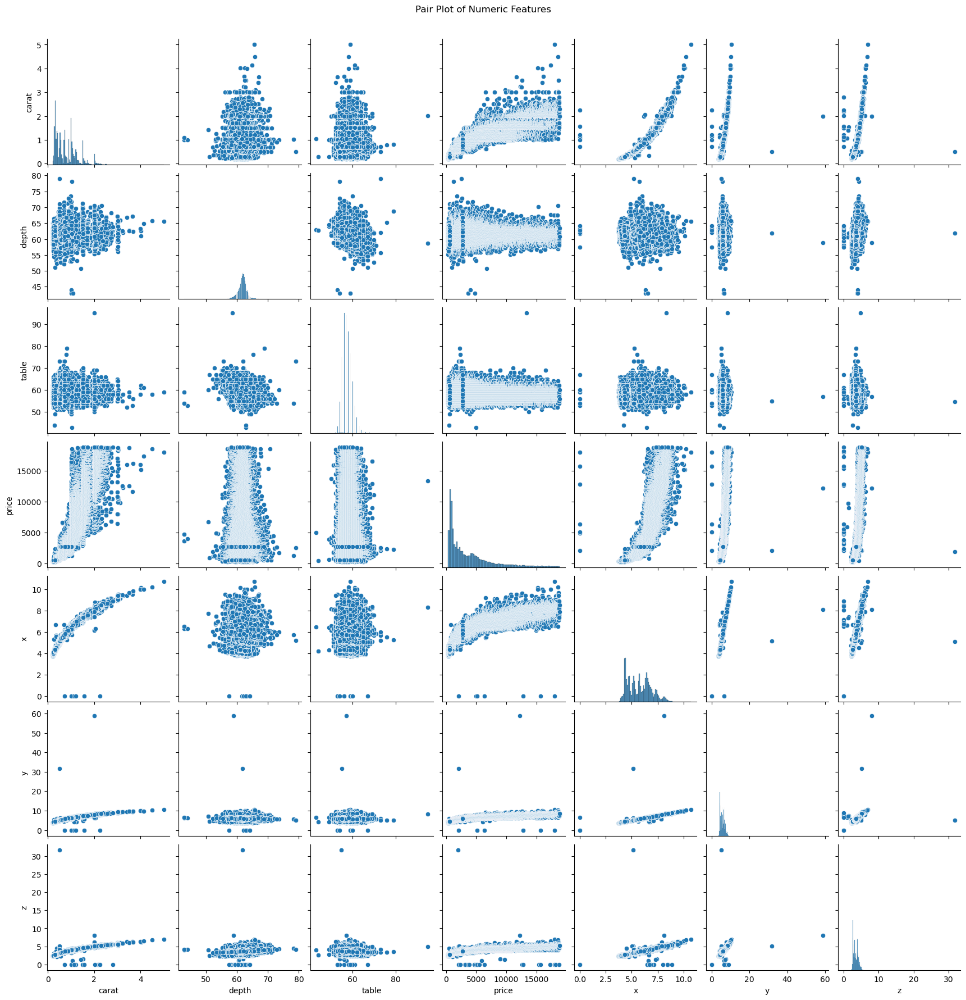

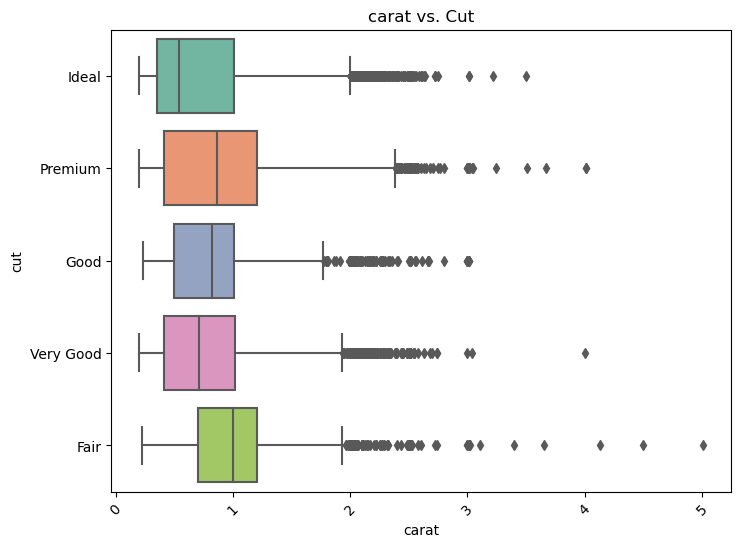

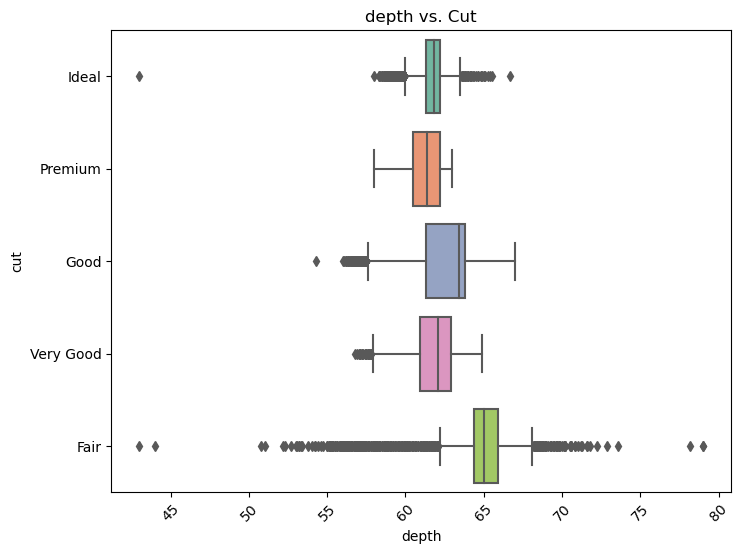

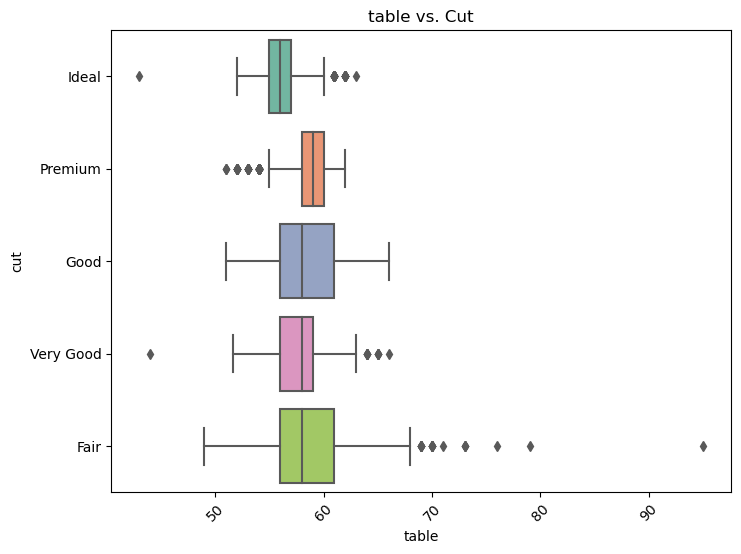

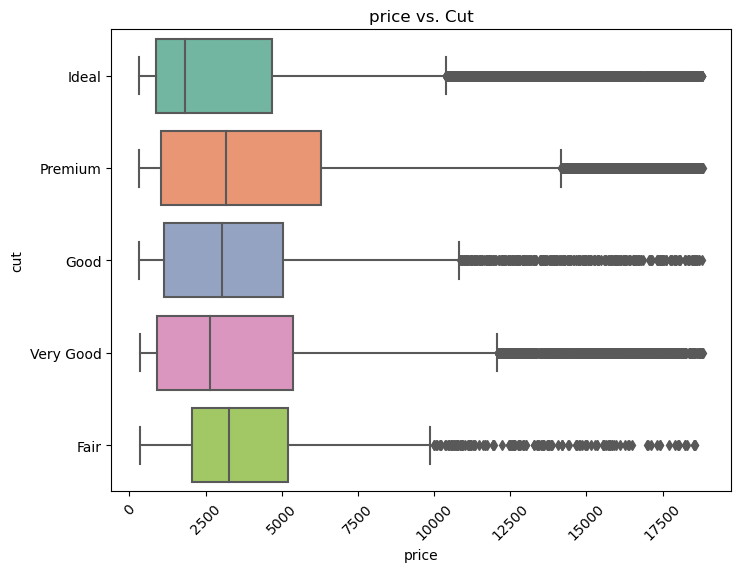

...

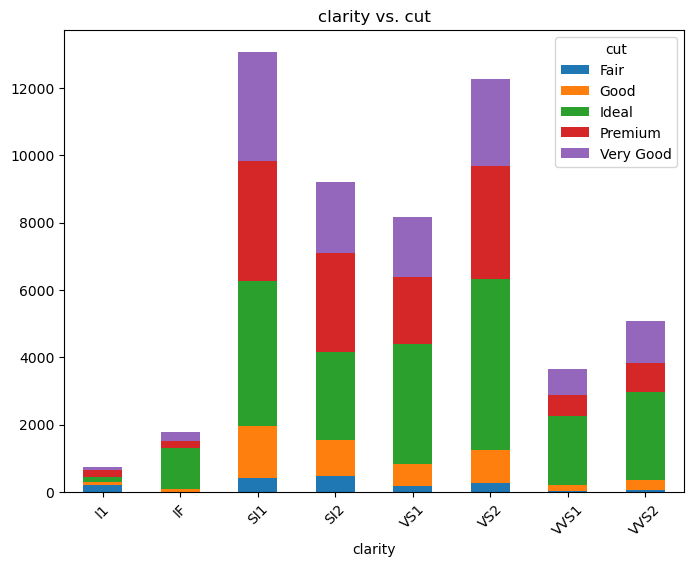

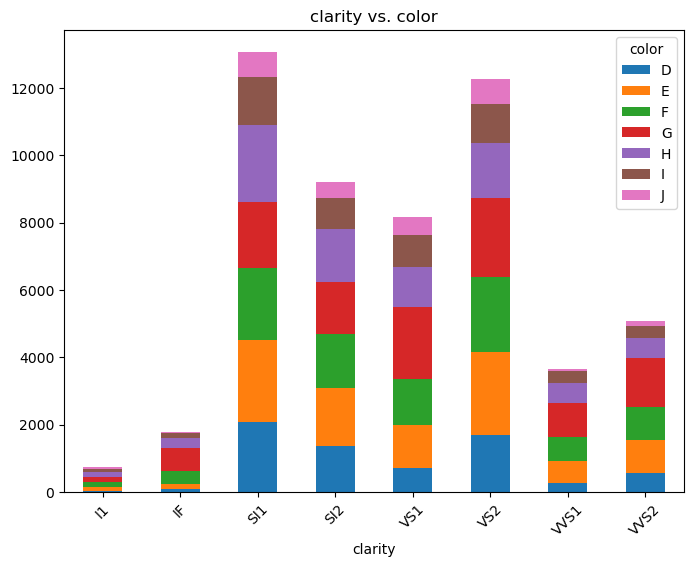

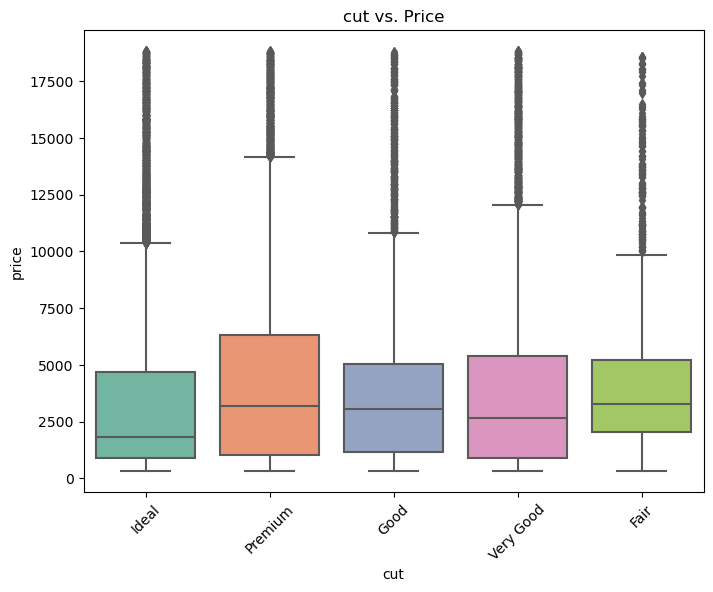

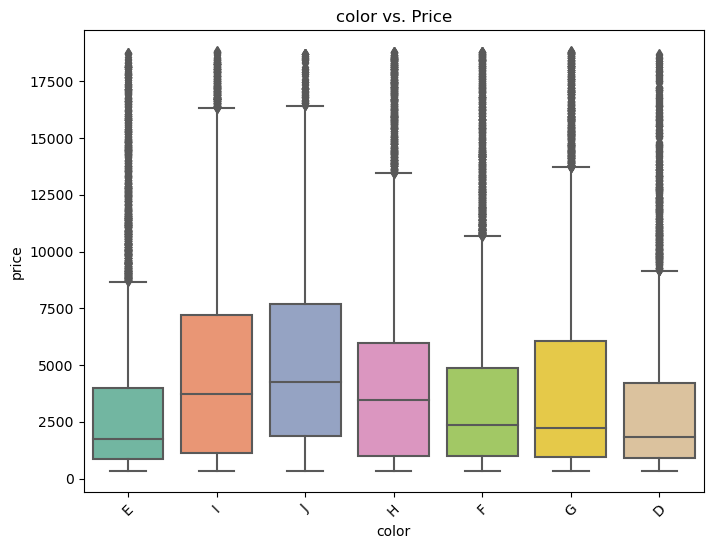

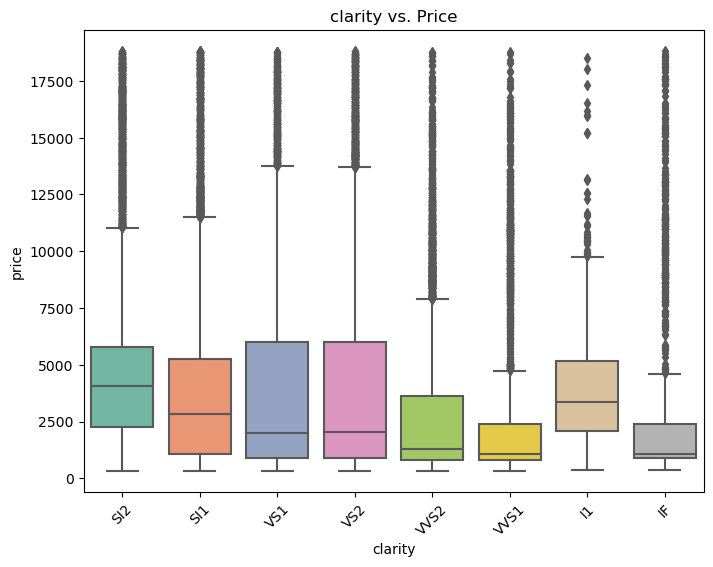

In [97]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Read the CSV file into a DataFrame
df = pd.read_csv(r'C:\Users\Sonu Vikas\Desktop\ANACONDA\AI,ML,DL\diamondsAIML.csv')

# Bivariate Plots - Numeric to Numeric
numeric_columns = ['carat', 'depth', 'table', 'price', 'x', 'y', 'z']

# Pair plot
sns.pairplot(df[numeric_columns])
plt.suptitle("Pair Plot of Numeric Features", y=1.02)
plt.show()

# Bivariate Plots - Numeric to Categorical
categorical_columns = ['cut', 'color', 'clarity']

# Box plots
for col in numeric_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=df, x=col, y='cut', palette='Set2')
    plt.title(f"{col} vs. Cut")
    plt.xticks(rotation=45)
    plt.show()

# Bivariate Plots - Categorical to Categorical
for col1 in categorical_columns:
    for col2 in categorical_columns:
        if col1 != col2:
            crosstab = pd.crosstab(df[col1], df[col2])
            crosstab.plot(kind='bar', stacked=True, figsize=(8, 6))
            plt.title(f"{col1} vs. {col2}")
            plt.xticks(rotation=45)
            plt.legend(title=col2)
            plt.show()

# Bivariate Plots - Categorical to Numeric
for col in categorical_columns:
    plt.figure(figsize=(8, 6))
    sns.boxplot(data=df, x=col, y='price', palette='Set2')
    plt.title(f"{col} vs. Price")
    plt.xticks(rotation=45)
    plt.show()


# Multivariate plots from the dataframe

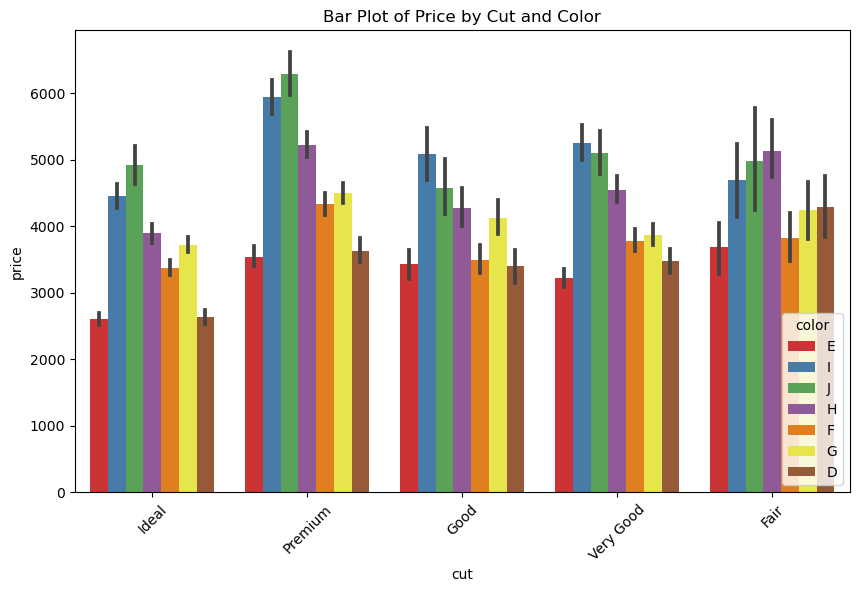

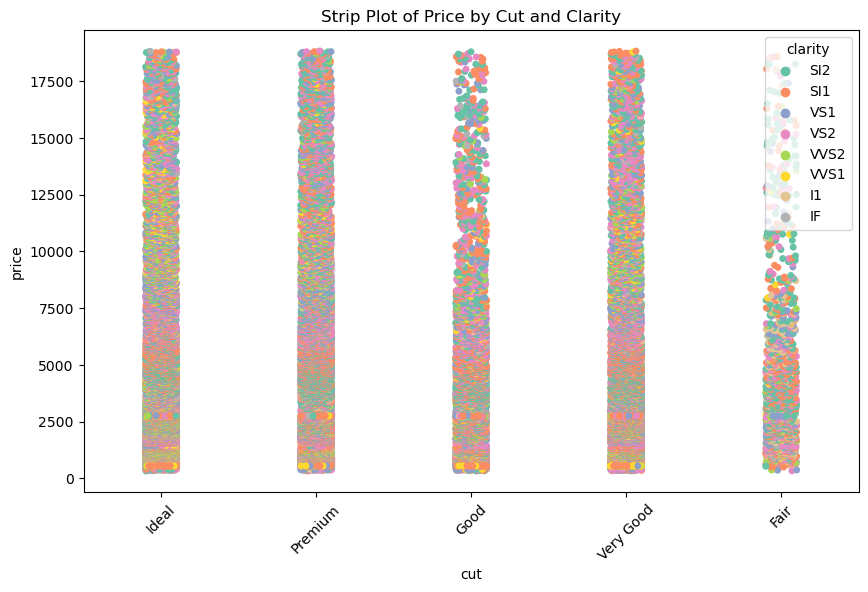

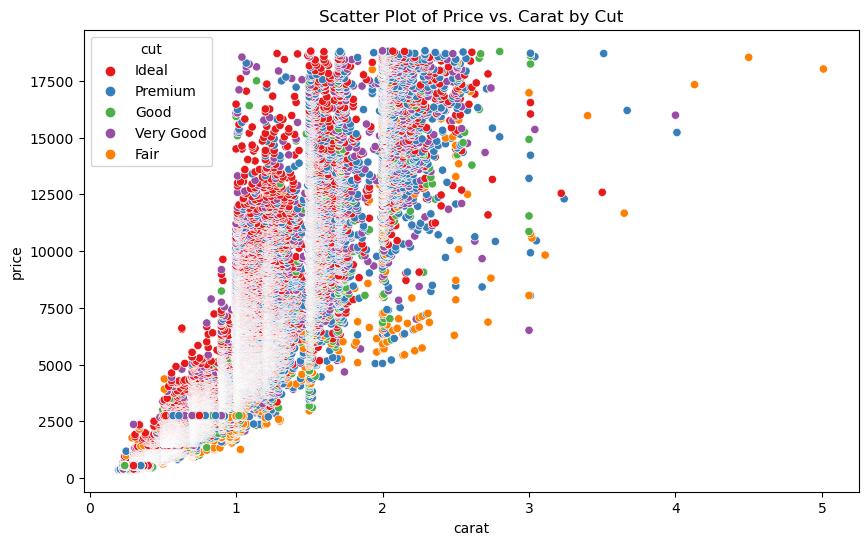

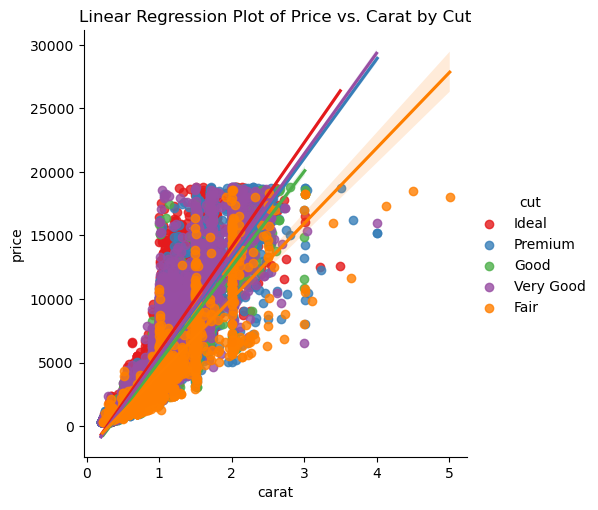

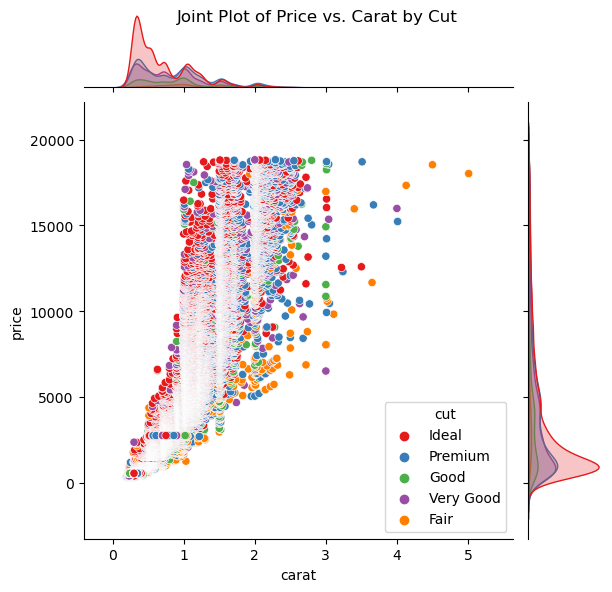

C:\Users\Sonu Vikas\AppData\Local\Temp\ipykernel_43592\2119905186.py:39: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



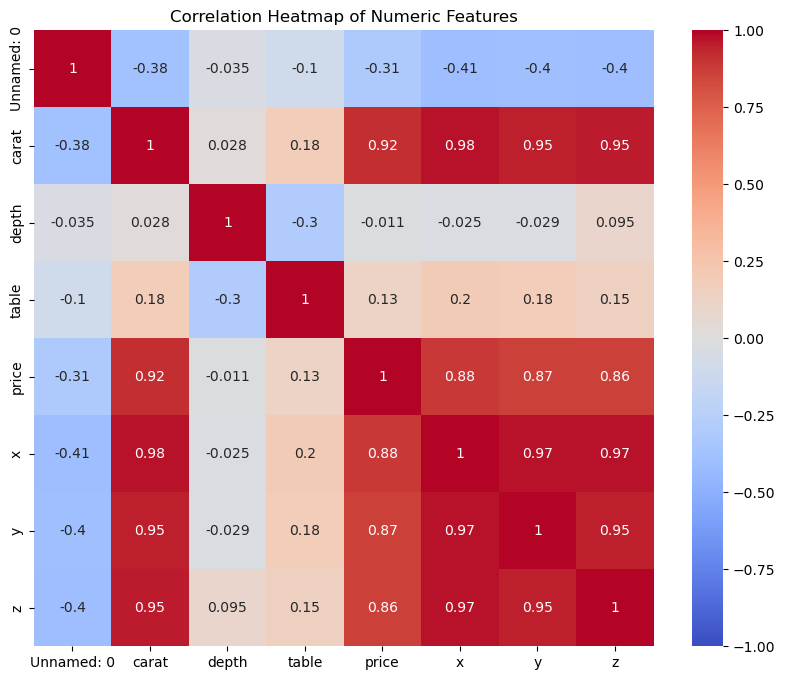

In [98]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Read the CSV file into a DataFrame
df = pd.read_csv(r'C:\Users\Sonu Vikas\Desktop\ANACONDA\AI,ML,DL\diamondsAIML.csv')

# Multivariate Analysis - Bar Plot
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x='cut', y='price', hue='color', palette='Set1')
plt.title("Bar Plot of Price by Cut and Color")
plt.xticks(rotation=45)
plt.show()

# Multivariate Analysis - Strip Plot
plt.figure(figsize=(10, 6))
sns.stripplot(data=df, x='cut', y='price', jitter=True, hue='clarity', palette='Set2')
plt.title("Strip Plot of Price by Cut and Clarity")
plt.xticks(rotation=45)
plt.show()

# Multivariate Analysis - Scatter Plot
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='carat', y='price', hue='cut', palette='Set1')
plt.title("Scatter Plot of Price vs. Carat by Cut")
plt.show()

# Multivariate Analysis - lmplot (Linear Regression Plot)
sns.lmplot(data=df, x='carat', y='price', hue='cut', palette='Set1')
plt.title("Linear Regression Plot of Price vs. Carat by Cut")
plt.show()

# Multivariate Analysis - Joint Plot
sns.jointplot(data=df, x='carat', y='price', kind='scatter', hue='cut', palette='Set1')
plt.suptitle("Joint Plot of Price vs. Carat by Cut")
plt.show()

# Multivariate Analysis - Heatmap
correlation_matrix = df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title("Correlation Heatmap of Numeric Features")
plt.show()


# Observations

# There is maximum correalation price vs carat and with price with column and next with cut

# There are outliers in every numerical column

# Price with increasing with increasing carats of diamond

# Price is not affected with increasing depth

# Price is also increases with clarity and column